# Semantic Segmentation of 4K Aerial Images of UAVid dataset

In this notebook we will go through the basics of what I did to train and several semantic segmentors to achive the tasks 


## Data Pre-processing and Preparation


### 1- Image split:
First of all, this dataset contain images of 4K resolution pictured from a drone, to get the best of the performence, it's better to make a type of "mosaic" out of each image. For example, to create 12 patches from each image - each patch 1024*1024 (White boundaries will appear in some patches, but it's fine, we will ignore them while training)
### 2- Relabelling of classes:
This task is considered to be a solution of a mobile robot that is being assisted by a drone above to achieve the task of navigation. Thus, we will relabel the original dataset to have only 4 labels:
   
   A- **Static** (Label # 0): Building, Tree, Low vegetation, Static Car
    
   B - **Road** (Label # 1): Road
    
   C - **Dynamic** (Label # 2) : Moving car, Human
    
   D - **Clutter** (Label # 3): Clutter 

The relabelling and splitting the images into patches are taking places using the following code: 

In [ ]:
import glob
import os
import numpy as np
import cv2
import multiprocessing.pool as mpp
import multiprocessing as mp
import time
import argparse
import torch
import albumentations as albu
import random




def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True


Building = np.array([128, 0, 0])  # label 0 Static
Road = np.array([128, 64, 128]) # label 1 Road
Tree = np.array([0, 128, 0]) # label 0 Static
LowVeg = np.array([128, 128, 0]) # label 0 Static
Moving_Car = np.array([64, 0, 128]) # label 2 Dynamic
Static_Car = np.array([192, 0, 192]) # label 0 Static
Human = np.array([64, 64, 0]) # label 2 Dynamic
Clutter = np.array([0, 0, 0]) # label 3 Clutter
Boundary = np.array([255, 255, 255]) # label 255

num_classes = 4

def rgb2label(label):
    label_seg = np.zeros(label.shape[:2], dtype=np.uint8)
    label_seg[np.all(label == Building, axis=-1)] = 0 #Static
    label_seg[np.all(label == Road, axis=-1)] = 1 #Road
    label_seg[np.all(label == Tree, axis=-1)] = 0 #Static
    label_seg[np.all(label == LowVeg, axis=-1)] = 0 #Static
    label_seg[np.all(label == Moving_Car, axis=-1)] = 2 #Dynamic
    label_seg[np.all(label == Static_Car, axis=-1)] = 0 #Static
    label_seg[np.all(label == Human, axis=-1)] = 2 #Dynamic
    label_seg[np.all(label == Clutter, axis=-1)] = 3 #Clutter
    label_seg[np.all(label == Boundary, axis=-1)] = 255 #Boundary
    return label_seg


def image_augment(image, mask):
    image_list = []
    mask_list = []
    image_width, image_height = image.shape[1], image.shape[0]
    mask_width, mask_height = mask.shape[1], mask.shape[0]
    assert image_height == mask_height and image_width == mask_width

    image_list_train = [image]
    mask_list_train = [mask]
    for i in range(len(image_list_train)):
        mask_tmp = rgb2label(mask_list_train[i])
        image_list.append(image_list_train[i])
        mask_list.append(mask_tmp)
    return image_list, mask_list


def padifneeded(image, mask):
    pad = albu.PadIfNeeded(min_height=2160, min_width=4096, position='bottom_right',
                           border_mode=0, value=[0, 0, 0], mask_value=[255, 255, 255])(image=image, mask=mask)
    img_pad, mask_pad = pad['image'], pad['mask']
    assert img_pad.shape[0] == 2048 or img_pad.shape[1] == 4096, print(img_pad.shape)

    return img_pad, mask_pad


def patch_format(inp):
    (input_dir, seq, imgs_output_dir, masks_output_dir, split_size, stride) = inp
    img_paths = glob.glob(os.path.join(input_dir, str(seq), 'Images',  "*.png"))
    mask_paths = glob.glob(os.path.join(input_dir, str(seq), 'Labels', "*.png"))
    for img_path, mask_path in zip(img_paths, mask_paths):
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        mask = cv2.imread(mask_path, cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
        id = os.path.splitext(os.path.basename(img_path))[0]
        assert img.shape == mask.shape and img.shape[0] == 2160, print(img.shape)
        assert img.shape[1] == 3840 or img.shape[1] == 4096, print(img.shape)
        img, mask = padifneeded(img.copy(), mask.copy())


        # img and mask shape: WxHxC
        image_list, mask_list = image_augment(image=img.copy(), mask=mask.copy())
        assert len(image_list) == len(mask_list)
        for m in range(len(image_list)):
            k = 0
            img = image_list[m]
            mask = mask_list[m]
            img, mask = img[-2048:, -4096:, :], mask[-2048:, -4096:]
            assert img.shape[0] == mask.shape[0] and img.shape[1] == mask.shape[1]
            for y in range(0, img.shape[0], stride[0]):
                for x in range(0, img.shape[1], stride[1]):
                    img_tile_cut = img[y:y + split_size[0], x:x + split_size[1]]
                    mask_tile_cut = mask[y:y + split_size[0], x:x + split_size[1]]
                    img_tile, mask_tile = img_tile_cut, mask_tile_cut

                    if img_tile.shape[0] == split_size[0] and img_tile.shape[1] == split_size[1] \
                            and mask_tile.shape[0] == split_size[0] and mask_tile.shape[1] == split_size[1]:
                        out_img_path = os.path.join(imgs_output_dir, "{}_{}_{}_{}.png".format(seq, id, m, k))
                        img_tile = cv2.cvtColor(img_tile, cv2.COLOR_RGB2BGR)
                        cv2.imwrite(out_img_path, img_tile)

                        out_mask_path = os.path.join(masks_output_dir,
                                                     "{}_{}_{}_{}.png".format(seq, id, m, k))
                        cv2.imwrite(out_mask_path, mask_tile)


                    k += 1


if __name__ == "__main__":
    seed_everything(42)
    input_dir="./uavid/uavid_val" #change this accordingly 
    output_img_dir="./uavid/val/images" #change this accordingly
    output_mask_dir="./uavid/val/masks" #change this accordingly
    split_size_h=1024
    split_size_w=1024
    stride_h=1024
    stride_w=1024
    input_dir = input_dir
    imgs_output_dir = output_img_dir
    masks_output_dir = output_mask_dir
    split_size_h = split_size_h
    split_size_w = split_size_w
    split_size = (split_size_h, split_size_w)
    stride_h = stride_h
    stride_w = stride_w
    stride = (stride_h, stride_w)
    seqs = os.listdir(input_dir)

    if not os.path.exists(imgs_output_dir):
        os.makedirs(imgs_output_dir)
    if not os.path.exists(masks_output_dir):
        os.makedirs(masks_output_dir)

    inp = [(input_dir, seq, imgs_output_dir, masks_output_dir, split_size, stride) for seq in seqs]

    mpp.Pool(processes=mp.cpu_count()).map(patch_format, inp)




# Dataloader for the dataset

The dataset itself has high-quality images, yet very little amount of images. 
Where there are 600 images for training and 70 for validation. 
A good practice here is to do image augmentation using the library of [**Albumentations**](https://albumentations.ai/) which is a Python library for fast and flexible image augmentations. 

Data augmentation is achieved through the following techniques:
1. Hue Saturation or Random Brightness & Contrast
2. Cutout
3. Motion Blur
4. Horizontal Flipping
5. Vertical Flipping
6. Rotation.

And to be more robust to the weather conditions (Important for an outdoor mobile robot,optinally apply weather effects such as:

7. Rain Effects
8. Sunny Effects
9. Snow Effects
10. Foggy Effects

In [1]:
import albumentations as A

def get_transforms(train=True,rain=None,sunny=None,snow=None,foggy=None):
    if train == True:
        Aug = [
                A.OneOf(
                    [
                        A.HueSaturationValue(
                            hue_shift_limit=0.1,
                            sat_shift_limit=0.1,
                            val_shift_limit=0.1,
                            p=0.7,
                        ),
                        A.RandomBrightnessContrast(
                            brightness_limit=0.15,
                            contrast_limit=0.15,
                            p=0.9
                        ),
                    ],
                    p=0.7,
                ),
                A.Cutout(
                    num_holes=8, max_h_size=24, max_w_size=24, fill_value=0, p=0.2
                ),
                A.MotionBlur(blur_limit=(3, 5), p=0),
                A.HorizontalFlip(p=0.5),
                A.VerticalFlip(p=0.5),
                A.RandomRotate90(p=0.5),
                A.Normalize(p=1.0),
            ]
        W = []
        if rain==True:
            # Rain effects
            W1 = A.RandomRain(
                slant_lower=-10,
                slant_upper=10,
                drop_length=15,
                drop_width=1,
                drop_color=(200, 200, 200),
                blur_value=12,
                brightness_coefficient=0.52,
                rain_type="heavy",
                p=0.25)
            W.append(W1)

            # Sunny effects.
        if sunny==True:
            W2 = A.RandomSunFlare(
                flare_roi=(0, 0, 1, 1),
                angle_lower=0,
                angle_upper=1,
                num_flare_circles_lower=4,
                num_flare_circles_upper=8,
                src_radius=100,
                src_color=(255, 255, 255),
                p=0.25)
            W.append(W2)
            # Snow effects.
        if snow==True:
            W3 = A.RandomSnow(
                snow_point_lower=0.1,
                snow_point_upper=0.3,
                brightness_coeff=2.5,
                p=0.25)
            W.append(W3)
            # Fog effects.
        if foggy==True:
            W4 = A.RandomFog(
                fog_coef_lower=0.3,
                fog_coef_upper=0.4,
                alpha_coef=0.1,
                p=0.01)
            W.append(W4)
        return A.Compose(Aug+W)
    else:
        return A.Compose([
            A.Normalize(p=1.0)])


A dataloader for UAVid dataset has been created to load each patches with masks and apply the previous data augmentation

In [2]:
from torch.utils.data import Dataset
import albumentations as albu
import numpy as np
import torch
from PIL import Image
import os
import os.path as osp
import random


CLASSES = ('Static','Road','Dynamic',"Clutter")
ORIGIN_IMG_SIZE = (1024, 1024)
INPUT_IMG_SIZE = (1024, 1024)
TEST_IMG_SIZE = (1024, 1024)

class UAVID(Dataset):
    def __init__(self, data_root='data/uavid/val', mode='val', img_dir='images', mask_dir='masks',
                 img_suffix='.png', mask_suffix='.png', transform=None, mosaic_ratio=0.0,
                 img_size=ORIGIN_IMG_SIZE):
        self.data_root = data_root
        self.img_dir = img_dir
        self.mask_dir = mask_dir
        self.img_suffix = img_suffix
        self.mask_suffix = mask_suffix
        self.transform = transform
        self.mode = mode
        self.mosaic_ratio = mosaic_ratio
        self.img_size = img_size
        self.img_ids = self.get_img_ids(self.data_root, self.img_dir, self.mask_dir)

    def __getitem__(self, index):
        p_ratio = random.random()
        if p_ratio > self.mosaic_ratio or self.mode == 'val' or self.mode == 'test':
            img, mask = self.load_img_and_mask(index)
            if self.transform:
                img, mask = np.array(img), np.array(mask)
                transformed= self.transform(image=img.copy(), mask=mask.copy())
                img = transformed["image"]
                mask = transformed["mask"]
            else:
                img, mask = np.array(img), np.array(mask)
        else:
            img, mask = self.load_mosaic_img_and_mask(index)
            if self.transform:
                img, mask = np.array(img), np.array(mask)
                transformed = self.transform(image=img.copy(), mask=mask.copy())
                img = transformed["image"]
                mask = transformed["mask"]
            else:
                img, mask = np.array(img), np.array(mask)

        img = torch.from_numpy(img).permute(2, 0, 1).float()
        mask = torch.from_numpy(mask).long()
        img_id = self.img_ids[index]
        results = {'img': img, 'gt_semantic_seg': mask, 'img_id': img_id}
        return results

    def __len__(self):
        return len(self.img_ids)

    def get_img_ids(self, data_root, img_dir, mask_dir):
        img_filename_list = os.listdir(osp.join(data_root, img_dir))
        mask_filename_list = os.listdir(osp.join(data_root, mask_dir))
        assert len(img_filename_list) == len(mask_filename_list)
        img_ids = [str(id.split('.')[0]) for id in mask_filename_list]
        return img_ids

    def load_img_and_mask(self, index):
        img_id = self.img_ids[index]
        img_name = osp.join(self.data_root, self.img_dir, img_id + self.img_suffix)
        mask_name = osp.join(self.data_root, self.mask_dir, img_id + self.mask_suffix)
        img = Image.open(img_name).convert('RGB')
        mask = Image.open(mask_name).convert('L')
        return img, mask

    def load_mosaic_img_and_mask(self, index):
        indexes = [index] + [random.randint(0, len(self.img_ids) - 1) for _ in range(3)]
        img_a, mask_a = self.load_img_and_mask(indexes[0])
        img_b, mask_b = self.load_img_and_mask(indexes[1])
        img_c, mask_c = self.load_img_and_mask(indexes[2])
        img_d, mask_d = self.load_img_and_mask(indexes[3])

        img_a, mask_a = np.array(img_a), np.array(mask_a)
        img_b, mask_b = np.array(img_b), np.array(mask_b)
        img_c, mask_c = np.array(img_c), np.array(mask_c)
        img_d, mask_d = np.array(img_d), np.array(mask_d)

        h = self.img_size[0]
        w = self.img_size[1]

        start_x = w // 4
        strat_y = h // 4
        # The coordinates of the splice center
        offset_x = random.randint(start_x, (w - start_x))
        offset_y = random.randint(strat_y, (h - strat_y))

        crop_size_a = (offset_x, offset_y)
        crop_size_b = (w - offset_x, offset_y)
        crop_size_c = (offset_x, h - offset_y)
        crop_size_d = (w - offset_x, h - offset_y)

        random_crop_a = albu.RandomCrop(width=crop_size_a[0], height=crop_size_a[1])
        random_crop_b = albu.RandomCrop(width=crop_size_b[0], height=crop_size_b[1])
        random_crop_c = albu.RandomCrop(width=crop_size_c[0], height=crop_size_c[1])
        random_crop_d = albu.RandomCrop(width=crop_size_d[0], height=crop_size_d[1])

        croped_a = random_crop_a(image=img_a.copy(), mask=mask_a.copy())
        croped_b = random_crop_b(image=img_b.copy(), mask=mask_b.copy())
        croped_c = random_crop_c(image=img_c.copy(), mask=mask_c.copy())
        croped_d = random_crop_d(image=img_d.copy(), mask=mask_d.copy())

        img_crop_a, mask_crop_a = croped_a['image'], croped_a['mask']
        img_crop_b, mask_crop_b = croped_b['image'], croped_b['mask']
        img_crop_c, mask_crop_c = croped_c['image'], croped_c['mask']
        img_crop_d, mask_crop_d = croped_d['image'], croped_d['mask']

        top = np.concatenate((img_crop_a, img_crop_b), axis=1)
        bottom = np.concatenate((img_crop_c, img_crop_d), axis=1)
        img = np.concatenate((top, bottom), axis=0)

        top_mask = np.concatenate((mask_crop_a, mask_crop_b), axis=1)
        bottom_mask = np.concatenate((mask_crop_c, mask_crop_d), axis=1)
        mask = np.concatenate((top_mask, bottom_mask), axis=0)
        mask = np.ascontiguousarray(mask)
        img = np.ascontiguousarray(img)
        img = Image.fromarray(img)
        mask = Image.fromarray(mask)
        return img, mask

# Evaluation


A class for calulcating accuracy metrics such as F1 score, mIoU, and per class Iou

In [3]:
import numpy as np

class Evaluator(object):
    def __init__(self, num_class):
        self.num_class = num_class
        self.confusion_matrix = np.zeros((self.num_class,) * 2)
        self.eps = 1e-8

    def get_tp_fp_tn_fn(self):
        tp = np.diag(self.confusion_matrix)
        fp = self.confusion_matrix.sum(axis=0) - np.diag(self.confusion_matrix)
        fn = self.confusion_matrix.sum(axis=1) - np.diag(self.confusion_matrix)
        tn = np.diag(self.confusion_matrix).sum() - np.diag(self.confusion_matrix)
        return tp, fp, tn, fn

    def Precision(self):
        tp, fp, tn, fn = self.get_tp_fp_tn_fn()
        precision = tp / (tp + fp)
        return precision

    def Recall(self):
        tp, fp, tn, fn = self.get_tp_fp_tn_fn()
        recall = tp / (tp + fn)
        return recall

    def F1(self):
        tp, fp, tn, fn = self.get_tp_fp_tn_fn()
        Precision = tp / (tp + fp)
        Recall = tp / (tp + fn)
        F1 = (2.0 * Precision * Recall) / (Precision + Recall)
        return F1

    def OA(self):
        OA = np.diag(self.confusion_matrix).sum() / (self.confusion_matrix.sum() + self.eps)
        return OA

    def Intersection_over_Union(self):
        tp, fp, tn, fn = self.get_tp_fp_tn_fn()
        IoU = tp / (tp + fn + fp)
        return IoU

    def Dice(self):
        tp, fp, tn, fn = self.get_tp_fp_tn_fn()
        Dice = 2 * tp / ((tp + fp) + (tp + fn))
        return Dice

    def Pixel_Accuracy_Class(self):
        #         TP                                  TP+FP
        Acc = np.diag(self.confusion_matrix) / (self.confusion_matrix.sum(axis=0) + self.eps)
        return Acc

    def Frequency_Weighted_Intersection_over_Union(self):
        freq = np.sum(self.confusion_matrix, axis=1) / (np.sum(self.confusion_matrix) + self.eps)
        iou = self.Intersection_over_Union()
        FWIoU = (freq[freq > 0] * iou[freq > 0]).sum()
        return FWIoU

    def _generate_matrix(self, gt_image, pre_image):
        mask = (gt_image >= 0) & (gt_image < self.num_class)
        label = self.num_class * gt_image[mask].astype('int') + pre_image[mask]
        count = np.bincount(label, minlength=self.num_class ** 2)
        confusion_matrix = count.reshape(self.num_class, self.num_class)
        return confusion_matrix

    def add_batch(self, gt_image, pre_image):
        assert gt_image.shape == pre_image.shape, 'pre_image shape {}, gt_image shape {}'.format(pre_image.shape,
                                                                                                 gt_image.shape)
        self.confusion_matrix += self._generate_matrix(gt_image, pre_image)

    def reset(self):
        self.confusion_matrix = np.zeros((self.num_class,) * 2)




# Ensemble Learning for UAVid

To solve this task, we will use ensemble learning of semantic segmentation. This means, to train several models ( I chose 3 models) and then get one predection out of 3 predection based on a weighted sum. 
To train/infer with three different models, we should have one framework to have a clean and undersstandable code. I chose PyTorch-Lightning. 
### What is lightning?
Lightning is a framework wrapper for pytorch (similar to Keras of TensorFlow). It has many useful functions that we would have to implement manually. Lightning has its own style of writing code, which allows us to make it modular and readable. 
* **Link to Official Lightning Website: https://pytorchlightning.ai/index.html**



## First Model : UNetFormer
This work has been proposed in [**This paper**](https://arxiv.org/abs/2109.08937). It's a hybrid architecture consisting of a CNN-based of ResNet18 encoder and a designed Transformer-based decoder. This architecture is done for real-time urban scene segmentation. 
The implemented PyTorch model of the network is: 

The model itself can be seen here

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from einops import rearrange, repeat

from timm.models.layers import DropPath, to_2tuple, trunc_normal_
import timm


class ConvBNReLU(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size=3, dilation=1, stride=1, norm_layer=nn.BatchNorm2d, bias=False):
        super(ConvBNReLU, self).__init__(
            nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, bias=bias,
                      dilation=dilation, stride=stride, padding=((stride - 1) + dilation * (kernel_size - 1)) // 2),
            norm_layer(out_channels),
            nn.ReLU6()
        )


class ConvBN(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size=3, dilation=1, stride=1, norm_layer=nn.BatchNorm2d, bias=False):
        super(ConvBN, self).__init__(
            nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, bias=bias,
                      dilation=dilation, stride=stride, padding=((stride - 1) + dilation * (kernel_size - 1)) // 2),
            norm_layer(out_channels)
        )


class Conv(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size=3, dilation=1, stride=1, bias=False):
        super(Conv, self).__init__(
            nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, bias=bias,
                      dilation=dilation, stride=stride, padding=((stride - 1) + dilation * (kernel_size - 1)) // 2)
        )


class SeparableConvBNReLU(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, dilation=1,
                 norm_layer=nn.BatchNorm2d):
        super(SeparableConvBNReLU, self).__init__(
            nn.Conv2d(in_channels, in_channels, kernel_size, stride=stride, dilation=dilation,
                      padding=((stride - 1) + dilation * (kernel_size - 1)) // 2,
                      groups=in_channels, bias=False),
            norm_layer(out_channels),
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
            nn.ReLU6()
        )


class SeparableConvBN(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, dilation=1,
                 norm_layer=nn.BatchNorm2d):
        super(SeparableConvBN, self).__init__(
            nn.Conv2d(in_channels, in_channels, kernel_size, stride=stride, dilation=dilation,
                      padding=((stride - 1) + dilation * (kernel_size - 1)) // 2,
                      groups=in_channels, bias=False),
            norm_layer(out_channels),
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False)
        )


class SeparableConv(nn.Sequential):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, dilation=1):
        super(SeparableConv, self).__init__(
            nn.Conv2d(in_channels, in_channels, kernel_size, stride=stride, dilation=dilation,
                      padding=((stride - 1) + dilation * (kernel_size - 1)) // 2,
                      groups=in_channels, bias=False),
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False)
        )


class Mlp(nn.Module):
    def __init__(self, in_features, hidden_features=None, out_features=None, act_layer=nn.ReLU6, drop=0.):
        super().__init__()
        out_features = out_features or in_features
        hidden_features = hidden_features or in_features
        self.fc1 = nn.Conv2d(in_features, hidden_features, 1, 1, 0, bias=True)
        self.act = act_layer()
        self.fc2 = nn.Conv2d(hidden_features, out_features, 1, 1, 0, bias=True)
        self.drop = nn.Dropout(drop, inplace=True)

    def forward(self, x):
        x = self.fc1(x)
        x = self.act(x)
        x = self.drop(x)
        x = self.fc2(x)
        x = self.drop(x)
        return x


class GlobalLocalAttention(nn.Module):
    def __init__(self,
                 dim=256,
                 num_heads=16,
                 qkv_bias=False,
                 window_size=8,
                 relative_pos_embedding=True
                 ):
        super().__init__()
        self.num_heads = num_heads
        head_dim = dim // self.num_heads
        self.scale = head_dim ** -0.5
        self.ws = window_size

        self.qkv = Conv(dim, 3*dim, kernel_size=1, bias=qkv_bias)
        self.local1 = ConvBN(dim, dim, kernel_size=3)
        self.local2 = ConvBN(dim, dim, kernel_size=1)
        self.proj = SeparableConvBN(dim, dim, kernel_size=window_size)

        self.attn_x = nn.AvgPool2d(kernel_size=(window_size, 1), stride=1,  padding=(window_size//2 - 1, 0))
        self.attn_y = nn.AvgPool2d(kernel_size=(1, window_size), stride=1, padding=(0, window_size//2 - 1))

        self.relative_pos_embedding = relative_pos_embedding

        if self.relative_pos_embedding:
            # define a parameter table of relative position bias
            self.relative_position_bias_table = nn.Parameter(
                torch.zeros((2 * window_size - 1) * (2 * window_size - 1), num_heads))  # 2*Wh-1 * 2*Ww-1, nH

            # get pair-wise relative position index for each token inside the window
            coords_h = torch.arange(self.ws)
            coords_w = torch.arange(self.ws)
            coords = torch.stack(torch.meshgrid([coords_h, coords_w]))  # 2, Wh, Ww
            coords_flatten = torch.flatten(coords, 1)  # 2, Wh*Ww
            relative_coords = coords_flatten[:, :, None] - coords_flatten[:, None, :]  # 2, Wh*Ww, Wh*Ww
            relative_coords = relative_coords.permute(1, 2, 0).contiguous()  # Wh*Ww, Wh*Ww, 2
            relative_coords[:, :, 0] += self.ws - 1  # shift to start from 0
            relative_coords[:, :, 1] += self.ws - 1
            relative_coords[:, :, 0] *= 2 * self.ws - 1
            relative_position_index = relative_coords.sum(-1)  # Wh*Ww, Wh*Ww
            self.register_buffer("relative_position_index", relative_position_index)

            trunc_normal_(self.relative_position_bias_table, std=.02)

    def pad(self, x, ps):
        _, _, H, W = x.size()
        if W % ps != 0:
            x = F.pad(x, (0, ps - W % ps), mode='reflect')
        if H % ps != 0:
            x = F.pad(x, (0, 0, 0, ps - H % ps), mode='reflect')
        return x

    def pad_out(self, x):
        x = F.pad(x, pad=(0, 1, 0, 1), mode='reflect')
        return x

    def forward(self, x):
        B, C, H, W = x.shape

        local = self.local2(x) + self.local1(x)

        x = self.pad(x, self.ws)
        B, C, Hp, Wp = x.shape
        qkv = self.qkv(x)

        q, k, v = rearrange(qkv, 'b (qkv h d) (hh ws1) (ww ws2) -> qkv (b hh ww) h (ws1 ws2) d', h=self.num_heads,
                            d=C//self.num_heads, hh=Hp//self.ws, ww=Wp//self.ws, qkv=3, ws1=self.ws, ws2=self.ws)

        dots = (q @ k.transpose(-2, -1)) * self.scale

        if self.relative_pos_embedding:
            relative_position_bias = self.relative_position_bias_table[self.relative_position_index.view(-1)].view(
                self.ws * self.ws, self.ws * self.ws, -1)  # Wh*Ww,Wh*Ww,nH
            relative_position_bias = relative_position_bias.permute(2, 0, 1).contiguous()  # nH, Wh*Ww, Wh*Ww
            dots += relative_position_bias.unsqueeze(0)

        attn = dots.softmax(dim=-1)
        attn = attn @ v

        attn = rearrange(attn, '(b hh ww) h (ws1 ws2) d -> b (h d) (hh ws1) (ww ws2)', h=self.num_heads,
                         d=C//self.num_heads, hh=Hp//self.ws, ww=Wp//self.ws, ws1=self.ws, ws2=self.ws)

        attn = attn[:, :, :H, :W]

        out = self.attn_x(F.pad(attn, pad=(0, 0, 0, 1), mode='reflect')) + \
              self.attn_y(F.pad(attn, pad=(0, 1, 0, 0), mode='reflect'))

        out = out + local
        out = self.pad_out(out)
        out = self.proj(out)
        # print(out.size())
        out = out[:, :, :H, :W]

        return out


class Block(nn.Module):
    def __init__(self, dim=256, num_heads=16,  mlp_ratio=4., qkv_bias=False, drop=0., attn_drop=0.,
                 drop_path=0., act_layer=nn.ReLU6, norm_layer=nn.BatchNorm2d, window_size=8):
        super().__init__()
        self.norm1 = norm_layer(dim)
        self.attn = GlobalLocalAttention(dim, num_heads=num_heads, qkv_bias=qkv_bias, window_size=window_size)

        self.drop_path = DropPath(drop_path) if drop_path > 0. else nn.Identity()
        mlp_hidden_dim = int(dim * mlp_ratio)
        self.mlp = Mlp(in_features=dim, hidden_features=mlp_hidden_dim, out_features=dim, act_layer=act_layer, drop=drop)
        self.norm2 = norm_layer(dim)

    def forward(self, x):

        x = x + self.drop_path(self.attn(self.norm1(x)))
        x = x + self.drop_path(self.mlp(self.norm2(x)))

        return x


class WF(nn.Module):
    def __init__(self, in_channels=128, decode_channels=128, eps=1e-8):
        super(WF, self).__init__()
        self.pre_conv = Conv(in_channels, decode_channels, kernel_size=1)

        self.weights = nn.Parameter(torch.ones(2, dtype=torch.float32), requires_grad=True)
        self.eps = eps
        self.post_conv = ConvBNReLU(decode_channels, decode_channels, kernel_size=3)

    def forward(self, x, res):
        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        weights = nn.ReLU()(self.weights)
        fuse_weights = weights / (torch.sum(weights, dim=0) + self.eps)
        x = fuse_weights[0] * self.pre_conv(res) + fuse_weights[1] * x
        x = self.post_conv(x)
        return x


class FeatureRefinementHead(nn.Module):
    def __init__(self, in_channels=64, decode_channels=64):
        super().__init__()
        self.pre_conv = Conv(in_channels, decode_channels, kernel_size=1)

        self.weights = nn.Parameter(torch.ones(2, dtype=torch.float32), requires_grad=True)
        self.eps = 1e-8
        self.post_conv = ConvBNReLU(decode_channels, decode_channels, kernel_size=3)

        self.pa = nn.Sequential(nn.Conv2d(decode_channels, decode_channels, kernel_size=3, padding=1, groups=decode_channels),
                                nn.Sigmoid())
        self.ca = nn.Sequential(nn.AdaptiveAvgPool2d(1),
                                Conv(decode_channels, decode_channels//16, kernel_size=1),
                                nn.ReLU6(),
                                Conv(decode_channels//16, decode_channels, kernel_size=1),
                                nn.Sigmoid())

        self.shortcut = ConvBN(decode_channels, decode_channels, kernel_size=1)
        self.proj = SeparableConvBN(decode_channels, decode_channels, kernel_size=3)
        self.act = nn.ReLU6()

    def forward(self, x, res):
        x = F.interpolate(x, scale_factor=2, mode='bilinear', align_corners=False)
        weights = nn.ReLU()(self.weights)
        fuse_weights = weights / (torch.sum(weights, dim=0) + self.eps)
        x = fuse_weights[0] * self.pre_conv(res) + fuse_weights[1] * x
        x = self.post_conv(x)
        shortcut = self.shortcut(x)
        pa = self.pa(x) * x
        ca = self.ca(x) * x
        x = pa + ca
        x = self.proj(x) + shortcut
        x = self.act(x)

        return x


class AuxHead(nn.Module):

    def __init__(self, in_channels=64, num_classes=8):
        super().__init__()
        self.conv = ConvBNReLU(in_channels, in_channels)
        self.drop = nn.Dropout(0.1)
        self.conv_out = Conv(in_channels, num_classes, kernel_size=1)

    def forward(self, x, h, w):
        feat = self.conv(x)
        feat = self.drop(feat)
        feat = self.conv_out(feat)
        feat = F.interpolate(feat, size=(h, w), mode='bilinear', align_corners=False)
        return feat


class Decoder(nn.Module):
    def __init__(self,
                 encoder_channels=(64, 128, 256, 512),
                 decode_channels=64,
                 dropout=0.1,
                 window_size=8,
                 num_classes=6):
        super(Decoder, self).__init__()

        self.pre_conv = ConvBN(encoder_channels[-1], decode_channels, kernel_size=1)
        self.b4 = Block(dim=decode_channels, num_heads=8, window_size=window_size)

        self.b3 = Block(dim=decode_channels, num_heads=8, window_size=window_size)
        self.p3 = WF(encoder_channels[-2], decode_channels)

        self.b2 = Block(dim=decode_channels, num_heads=8, window_size=window_size)
        self.p2 = WF(encoder_channels[-3], decode_channels)

        if self.training:
            self.up4 = nn.UpsamplingBilinear2d(scale_factor=4)
            self.up3 = nn.UpsamplingBilinear2d(scale_factor=2)
            self.aux_head = AuxHead(decode_channels, num_classes)

        self.p1 = FeatureRefinementHead(encoder_channels[-4], decode_channels)

        self.segmentation_head = nn.Sequential(ConvBNReLU(decode_channels, decode_channels),
                                               nn.Dropout2d(p=dropout, inplace=True),
                                               Conv(decode_channels, num_classes, kernel_size=1))
        self.init_weight()

    def forward(self, res1, res2, res3, res4, h, w):
        if self.training:
            x = self.b4(self.pre_conv(res4))
            h4 = self.up4(x)

            x = self.p3(x, res3)
            x = self.b3(x)
            h3 = self.up3(x)

            x = self.p2(x, res2)
            x = self.b2(x)
            h2 = x
            x = self.p1(x, res1)
            x = self.segmentation_head(x)
            x = F.interpolate(x, size=(h, w), mode='bilinear', align_corners=False)

            ah = h4 + h3 + h2
            ah = self.aux_head(ah, h, w)

            return x, ah
        else:
            x = self.b4(self.pre_conv(res4))
            x = self.p3(x, res3)
            x = self.b3(x)

            x = self.p2(x, res2)
            x = self.b2(x)

            x = self.p1(x, res1)

            x = self.segmentation_head(x)
            x = F.interpolate(x, size=(h, w), mode='bilinear', align_corners=False)

            return x

    def init_weight(self):
        for m in self.children():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, a=1)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)


class UNetFormer(nn.Module):
    def __init__(self,
                 decode_channels=64,
                 dropout=0.1,
                 backbone_name='swsl_resnet18',
                 pretrained=True,
                 window_size=8,
                 num_classes=6
                 ):
        super().__init__()

        self.backbone = timm.create_model(backbone_name, features_only=True, output_stride=32,
                                          out_indices=(1, 2, 3, 4), pretrained=pretrained)
        encoder_channels = self.backbone.feature_info.channels()

        self.decoder = Decoder(encoder_channels, decode_channels, dropout, window_size, num_classes)

    def forward(self, x):
        h, w = x.size()[-2:]
        res1, res2, res3, res4 = self.backbone(x)
        if self.training:
            x, ah = self.decoder(res1, res2, res3, res4, h, w)
            return x, ah
        else:
            x = self.decoder(res1, res2, res3, res4, h, w)
            return x

For each network, we should provide two things:
1. Config File: 
Contains the network itself, hyperparameters of learning, dataloaders for training and validation, optimizer and scheduler 
2. Lightning Module of the network: 
Contains the forward step in the network, trainging and validation step, and steps needed to be done at the end of each part of learning process


**Please insert the path of the dataset**

In [4]:
# Please put the path of the dataset
DATA_DIR = "/media/ami/big_space/sber_task/uavid" 

In [22]:
# The config file of UNetFormer:

In [13]:
import torch
from src.loss.UNetFormer_loss import UnetFormerLoss
from src.models.UNetFormer import UNetFormer
from catalyst.contrib.nn import Lookahead
from catalyst import utils
from datetime import datetime
import os

CLASSES = ('Static','Road','Dynamic',"Clutter")
num_classes = len(CLASSES)
classes = CLASSES

BASE_DIR = os.getcwd()
MODELS_DIR = f"{BASE_DIR}/results"
LOGS_DIR = f"{BASE_DIR}/logs"

now = datetime.now()
dt_string = now.strftime("%d_%m_%Y_%H:%M")
experiment_name = "Unetformer_{}".format(dt_string)


# training hparam
max_epoch = 40
ignore_index = 255 #class to ignore
train_batch_size = 8
val_batch_size = 8
accumulate_bs = 8
lr = 6e-4
weight_decay = 0.01
backbone_lr = 6e-5
backbone_weight_decay = 0.01

net_name = "Unetformer"
weights_name = "unetformer-r18-1024-tiles-e{}".format(max_epoch)
weights_path = "model_weights/uavid/{}".format(weights_name)
test_weights_name = "last"

# For callbacks
log_name = 'uavid/{}'.format(weights_name)
monitor = 'val_mIoU'
monitor_mode = 'max'
save_top_k = 1
save_last = True
check_val_every_n_epoch = 1
pretrained_ckpt_path = None #In case of resume training - the path for the pretrained models weight
gpus = 'auto'  # auto means default setting or gpu ids:[0] or gpu nums: 2
enable_checkpointing = None  # whether continue training with the checkpoint, default None

#  define the network
net = UNetFormer(num_classes=num_classes)
# define the loss
loss = UnetFormerLoss(ignore_index=ignore_index)

# define the optimizer and scheduler

layerwise_params = {"backbone.*": dict(lr=backbone_lr, weight_decay=backbone_weight_decay)}
net_params = utils.process_model_params(net, layerwise_params=layerwise_params)
base_optimizer = torch.optim.AdamW(net_params, lr=lr, weight_decay=weight_decay)
optimizer = Lookahead(base_optimizer)

lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=max_epoch)



/home/ami/anaconda3/envs/airs/lib/python3.9/site-packages/torch/functional.py:504: UserWarning:

torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)



In [ ]:
# The Lightning module of UNetFormer:

In [14]:
import torch
from torch import nn
import pytorch_lightning as pl
from utils.metric import Evaluator
import numpy as np
from src.dataset.uavid_dataset import *
from src.dataset.image_transforms import get_transforms
from torch.utils.data import DataLoader

class UnetFormerModule(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.net = net

        self.loss = loss
        self.num_classes = num_classes
        self.classes = classes
        self.optimizer = optimizer
        self.lr_scheduler = lr_scheduler
        self.DATA_DIR = DATA_DIR
        self.train_batch_size = train_batch_size
        self.val_batch_size = val_batch_size

        self.metrics_train = Evaluator(num_class=num_classes)
        self.metrics_val = Evaluator(num_class=num_classes)

    def forward(self, x):
        # only net is used in the prediction/inference
        outputs = self.net(x)
        return outputs

    def training_step(self, batch, batch_idx):
        img, mask = batch['img'], batch['gt_semantic_seg']

        prediction = self.net(img)
        loss = self.loss(prediction, mask)


        pre_mask = nn.Softmax(dim=1)(prediction[0])


        pre_mask = pre_mask.argmax(dim=1)
        for i in range(mask.shape[0]):
            self.metrics_train.add_batch(mask[i].cpu().numpy(), pre_mask[i].cpu().numpy())

        return {"loss": loss}

    def on_train_epoch_end(self):

        mIoU = np.nanmean(self.metrics_train.Intersection_over_Union())
        F1 = np.nanmean(self.metrics_train.F1())

        OA = np.nanmean(self.metrics_train.OA())
        iou_per_class = self.metrics_train.Intersection_over_Union()
        eval_value = {'mIoU': mIoU,
                      'F1': F1,
                      'OA': OA}
        print('train:', eval_value)

        iou_value = {}
        for class_name, iou in zip(self.classes, iou_per_class):
            iou_value[class_name] = iou
        self.metrics_train.reset()
        log_dict = {'train_mIoU': mIoU, 'train_F1': F1, 'train_OA': OA}
        self.log_dict(log_dict, prog_bar=True)

    def validation_step(self, batch, batch_idx):
        img, mask = batch['img'], batch['gt_semantic_seg']
        prediction = self.forward(img)
        pre_mask = nn.Softmax(dim=1)(prediction)
        pre_mask = pre_mask.argmax(dim=1)
        for i in range(mask.shape[0]):
            self.metrics_val.add_batch(mask[i].cpu().numpy(), pre_mask[i].cpu().numpy())

        loss_val = self.loss(prediction, mask)
        return {"loss_val": loss_val}

    def on_validation_epoch_end(self):

        mIoU = np.nanmean(self.metrics_val.Intersection_over_Union())
        F1 = np.nanmean(self.metrics_val.F1())

        OA = np.nanmean(self.metrics_val.OA())
        iou_per_class = self.metrics_val.Intersection_over_Union()

        eval_value = {'mIoU': mIoU,
                      'F1': F1,
                      'OA': OA}
        print('val:', eval_value)
        iou_value = {}
        for class_name, iou in zip(self.classes, iou_per_class):
            iou_value[class_name] = iou

        self.metrics_val.reset()
        log_dict = {'val_mIoU': mIoU, 'val_F1': F1, 'val_OA': OA}
        self.log_dict(log_dict, prog_bar=True)
        self.log_dict(iou_value)

    def configure_optimizers(self):
        optimizer = self.optimizer
        lr_scheduler = self.lr_scheduler

        return [optimizer], [lr_scheduler]

    def setup(self, stage=None):
        train_dataset = UAVID(data_root=self.DATA_DIR + '/train', img_dir='images', mask_dir='masks',
                              mode='train', mosaic_ratio=0.25,
                              transform=get_transforms(train=True, rain=True, foggy=True), img_size=(1024, 1024))

        val_dataset = UAVID(data_root=self.DATA_DIR + '/val', img_dir='images', mask_dir='masks', mode='val',
                            mosaic_ratio=0.0, transform=get_transforms(train=False), img_size=(1024, 1024))

        train_loader = DataLoader(dataset=train_dataset,
                                  batch_size=self.train_batch_size,
                                  num_workers=4,
                                  pin_memory=True,
                                  shuffle=True,
                                  drop_last=True)

        val_loader = DataLoader(dataset=val_dataset,
                                batch_size=self.val_batch_size,
                                num_workers=4,
                                shuffle=False,
                                pin_memory=True,
                                drop_last=False)

        self.train_dataset = train_dataset
        self.valid_dataset = val_dataset
        self.train_loader = train_loader
        self.val_loader = val_loader

    def train_dataloader(self):

        return self.train_loader

    def val_dataloader(self):

        return self.val_loader




## Second Model : Segformer 
Another network chosen by me due to its very good performance on the task of semantic segmantation. A Transformer-based framework for semantic segmentation that unifies Transformers with lightweight multilayer perceptron (MLP) decoders. This architecture showed very good results for semantic segmentation. I had a chance to work a little bit  with it during one project within Sber. I used Segformer-B0 encoder (the fastest).

In [ ]:
# The config file of Segformer:

In [5]:
from catalyst import utils
from transformers import SegformerForSemanticSegmentation
import os
from torch.optim import lr_scheduler
from datetime import datetime
import torch


CLASSES = ('Static','Road','Dynamic',"Clutter")

num_classes = len(CLASSES)
classes = CLASSES

BASE_DIR = os.getcwd()
MODELS_DIR = f"{BASE_DIR}/results"
LOGS_DIR = f"{BASE_DIR}/logs"

now = datetime.now()
dt_string = now.strftime("%d_%m_%Y_%H:%M")
experiment_name = "Segformer_{}".format(dt_string)


# training hparam
max_epoch = 40
train_batch_size = 6
val_batch_size = 6
accumulate_bs = 8

lr = 6e-5 * 8
# scheduler
step = [20, 45, 90]
gamma = 0.2

net_name = "Segformer"
weights_name = "segformer-e{}".format(max_epoch)
weights_path = "model_weights/uavid/{}".format(weights_name)
test_weights_name = "last"

# For callbacks
log_name = 'uavid/{}'.format(weights_name)
monitor = 'val_mIoU'
monitor_mode = 'max'
save_top_k = 1
save_last = True
check_val_every_n_epoch = 1
pretrained_ckpt_path = None #In case of resume training - the path for the pretrained models weight
gpus = 'auto'  # auto means default setting or gpu ids:[0] or gpu nums: 2
enable_checkpointing = None  # whether continue training with the checkpoint, default None


id2label = {0: 0, 1: 1, 2: 2, 3: 3}
label2id = {v: k for k, v in id2label.items()}

net = SegformerForSemanticSegmentation.from_pretrained(
            "nvidia/mit-b0",
            num_labels=num_classes,
            id2label=id2label,
            label2id=label2id,
        )

# define the optimizer and scheduler
net_params = utils.process_model_params(net)
optimizer = torch.optim.AdamW(net_params, lr=lr, amsgrad=False)
lr_scheduler = lr_scheduler.MultiStepLR(optimizer, milestones=step, gamma=gamma)


Some weights of the model checkpoint at nvidia/mit-b0 were not used when initializing SegformerForSemanticSegmentation: ['classifier.bias', 'classifier.weight']
- This IS expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b0 and are newly initialized: ['decode_head.linear_c.2.proj.bias', 'decode_head.linear_fuse.weight', 'decode_head.linear_c.1.proj.bias', 'decode_head.batch_norm.bias', 'decode_head.batch_norm.running_var', 'decode_head.batch_norm.

In [ ]:
# The Lightning module of Segformer:

In [6]:
import torch
from torch import nn
import pytorch_lightning as pl
from utils.metric import Evaluator
import numpy as np
from src.dataset.uavid_dataset import *
from src.dataset.image_transforms import get_transforms
from torch.utils.data import DataLoader



class SegFormerModule(pl.LightningModule):
    def __init__(
            self
    ):
        super().__init__()

        self.num_classes = num_classes
        self.classes = classes
        self.optimizer = optimizer
        self.lr_scheduler = lr_scheduler
        self.DATA_DIR = DATA_DIR
        self.train_batch_size = train_batch_size
        self.val_batch_size = val_batch_size
        self.net = net
        self.metrics_train = Evaluator(num_class=num_classes)
        self.metrics_val = Evaluator(num_class=num_classes)


    def forward(self, pixel_values, labels):
        outputs = self.net(pixel_values=pixel_values, labels=labels)
        return outputs

    def configure_optimizers(self):
        optimizer = self.optimizer
        lr_scheduler = self.lr_scheduler

        return [optimizer], [lr_scheduler]

    def training_step(self, train_batch, batch_idx):
        images, targets = train_batch['img'], train_batch['gt_semantic_seg']
        images, targets = images.type(torch.float32), targets.type(torch.long)

        outputs = self.net(pixel_values=images, labels=targets)
        loss, logits = outputs.loss, outputs.logits
        upsampled_logits = nn.functional.interpolate(logits,
                                                     size=targets.size(dim=1),  # (height, width)
                                                     mode='bilinear',
                                                     align_corners=False)
        pre_mask = upsampled_logits.argmax(dim=1)
        for i in range(targets.shape[0]):
            self.metrics_train.add_batch(targets[i].cpu().numpy(), pre_mask[i].cpu().numpy())
        return {"loss": loss}

    def on_train_epoch_end(self):
        mIoU = np.nanmean(self.metrics_train.Intersection_over_Union())
        F1 = np.nanmean(self.metrics_train.F1())

        OA = np.nanmean(self.metrics_train.OA())
        iou_per_class = self.metrics_train.Intersection_over_Union()
        eval_value = {'mIoU': mIoU,
                      'F1': F1,
                      'OA': OA}
        print('train:', eval_value)

        iou_value = {}
        for class_name, iou in zip(self.classes, iou_per_class):
            iou_value[class_name] = iou
        print(iou_value)
        self.metrics_train.reset()
        log_dict = {'train_mIoU': mIoU, 'train_F1': F1, 'train_OA': OA}
        self.log_dict(log_dict, prog_bar=True)

    def validation_step(self, val_batch, batch_idx):
        images, targets = val_batch['img'], val_batch['gt_semantic_seg']
        images, targets = images.type(torch.float32), targets.type(torch.long)

        outputs = self.net(pixel_values=images, labels=targets)
        loss_val, logits_val = outputs.loss, outputs.logits
        upsampled_logits = nn.functional.interpolate(logits_val,
                                                     size=targets.size(dim=1),  # (height, width)
                                                     mode='bilinear',
                                                     align_corners=False)
        pre_mask = upsampled_logits.argmax(dim=1)
        for i in range(targets.shape[0]):
            self.metrics_val.add_batch(targets[i].cpu().numpy(), pre_mask[i].cpu().numpy())

        return {"loss_val": loss_val}

    def on_validation_epoch_end(self):
        mIoU = np.nanmean(self.metrics_val.Intersection_over_Union())
        F1 = np.nanmean(self.metrics_val.F1())

        OA = np.nanmean(self.metrics_val.OA())
        iou_per_class = self.metrics_val.Intersection_over_Union()

        eval_value = {'mIoU': mIoU,
                      'F1': F1,
                      'OA': OA}
        print('val:', eval_value)
        iou_value = {}
        for class_name, iou in zip(self.classes, iou_per_class):
            iou_value[class_name] = iou
        print(iou_value)

        self.metrics_val.reset()
        log_dict = {'val_mIoU': mIoU, 'val_F1': F1, 'val_OA': OA}
        self.log_dict(log_dict, prog_bar=True)
        self.log_dict(iou_value)

    def test_step(self, batch, batch_idx):
        return self.validation_step(batch, batch_idx)

    def collate_fn(self, batch):
        return tuple(zip(*batch))

    def setup(self, stage=None):

        train_dataset = UAVID(data_root=self.DATA_DIR + '/train', img_dir='images', mask_dir='masks',
                              mode='train', mosaic_ratio=0.25, transform=get_transforms(train=True),
                              img_size=(1024, 1024))

        val_dataset = UAVID(data_root=self.DATA_DIR + '/val', img_dir='images', mask_dir='masks', mode='val',
                            mosaic_ratio=0.0, transform=get_transforms(train=False), img_size=(1024, 1024))

        train_loader = DataLoader(dataset=train_dataset,
                                  batch_size=self.train_batch_size,
                                  num_workers=4,
                                  pin_memory=True,
                                  shuffle=True,
                                  drop_last=True)

        val_loader = DataLoader(dataset=val_dataset,
                                batch_size=self.val_batch_size,
                                num_workers=4,
                                shuffle=False,
                                pin_memory=True,
                                drop_last=False)
        self.train_dataset = train_dataset
        self.valid_dataset = val_dataset
        self.train_loader = train_loader
        self.val_loader = val_loader

    def train_dataloader(self):
        return self.train_loader

    def val_dataloader(self):
        return self.val_loader

    def test_dataloader(self):
        return self.val_loader




## Third Model : Feature Pyramid Network for Multi-Class Land Segmentation
This model was made based on a fully convolutional neural network of feature pyramid network (FPN) family. This network is consisted of pre-trained on ImageNet Resnet50 encoder and neatly developed decoder

In [6]:
# The config file of FPN:

In [16]:
import os
import torch
from catalyst import utils
import segmentation_models_pytorch as smp
from src.loss.soft_ce import SoftCrossEntropyLoss
from datetime import datetime

CLASSES = ('Static','Road','Dynamic',"Clutter")
num_classes = len(CLASSES)
classes = CLASSES

BASE_DIR = os.getcwd()
MODELS_DIR = f"{BASE_DIR}/results"
LOGS_DIR = f"{BASE_DIR}/logs"


now = datetime.now()
dt_string = now.strftime("%d_%m_%Y_%H:%M")
experiment_name = "Feature_pyramid_net{}".format(dt_string)


# training hparam
max_epoch = 40
ignore_index = 255 #class to ignore
train_batch_size = 4
val_batch_size = 4
lr = 0.001
weight_decay = 0.0003
backbone_lr = 0.0005
backbone_weight_decay = 0.00003

net_name = "FPN"
weights_name = "fpn-resnext50_32x4d-e{}".format(max_epoch)
weights_path = "model_weights/uavid/{}".format(weights_name)
test_weights_name = "last"

# For callbacks
log_name = 'uavid/{}'.format(weights_name)
monitor = 'val_mIoU'
monitor_mode = 'max'
save_top_k = 1
save_last = True
check_val_every_n_epoch = 1
pretrained_ckpt_path = None #In case of resume training - the path for the pretrained models weight
gpus = 'auto'  # auto means default setting or gpu ids:[0] or gpu nums: 2
enable_checkpointing = None  # whether continue training with the checkpoint, default None

#  define the network
net = smp.FPN(encoder_name="resnext50_32x4d", classes=num_classes)
# define the loss
loss = SoftCrossEntropyLoss(smooth_factor=0.05, ignore_index=ignore_index)


# define the optimizer and scheduler
# Since we use a pre-trained encoder, we will reduce the learning rate on it.
layerwise_params = {"encoder*": dict(lr=backbone_lr, weight_decay=backbone_weight_decay)}

# This function removes weight_decay for biases and applies our layerwise_params
model_params = utils.process_model_params(net, layerwise_params=layerwise_params)

optimizer = torch.optim.Adam(model_params, lr=lr, weight_decay=weight_decay)

lr_scheduler = {'scheduler': torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.25,patience=2, mode=monitor_mode)
                ,'name': 'learning_rate'
                ,'monitor': monitor}


In [ ]:
# The Lightning module of FPN:

In [17]:
import torch
from torch import nn
import pytorch_lightning as pl
from utils.metric import Evaluator
import numpy as np
from src.dataset.uavid_dataset import *
from src.dataset.image_transforms import get_transforms
from torch.utils.data import DataLoader

class FPNetModule(pl.LightningModule):

    def __init__(self):
        super().__init__()
        self.net = net

        self.loss = loss
        self.num_classes = num_classes
        self.classes = classes
        self.optimizer = optimizer
        self.lr_scheduler = lr_scheduler
        self.DATA_DIR = DATA_DIR
        self.train_batch_size = train_batch_size
        self.val_batch_size = val_batch_size

        self.metrics_train = Evaluator(num_class=num_classes)
        self.metrics_val = Evaluator(num_class=num_classes)



    def forward(self, x):
        return self.net.forward(x)

    def training_step(self, batch, batch_idx):
        img, targets = batch['img'], batch['gt_semantic_seg']

        prediction = self.net(img)

        loss = self.loss(prediction, targets)

        pre_mask = prediction.argmax(dim=1)
        for i in range(targets.shape[0]):
            self.metrics_train.add_batch(targets[i].cpu().numpy(), pre_mask[i].cpu().numpy())
        return {"loss": loss}
    def on_train_epoch_end(self):
        mIoU = np.nanmean(self.metrics_train.Intersection_over_Union())
        F1 = np.nanmean(self.metrics_train.F1())

        OA = np.nanmean(self.metrics_train.OA())
        iou_per_class = self.metrics_train.Intersection_over_Union()
        eval_value = {'mIoU': mIoU,
                      'F1': F1,
                      'OA': OA}
        print('train:', eval_value)

        iou_value = {}
        for class_name, iou in zip(self.classes, iou_per_class):
            iou_value[class_name] = iou
        print(iou_value)
        self.metrics_train.reset()
        log_dict = {'train_mIoU': mIoU, 'train_F1': F1, 'train_OA': OA}
        self.log_dict(log_dict, prog_bar=True)


    def validation_step(self, batch, batch_idx):
        img, targets = batch['img'], batch['gt_semantic_seg']

        prediction = self.net(img)

        loss = self.loss(prediction, targets)

        pre_mask = prediction.argmax(dim=1)
        for i in range(targets.shape[0]):
            self.metrics_val.add_batch(targets[i].cpu().numpy(), pre_mask[i].cpu().numpy())
        return {"loss": loss}

    def on_validation_epoch_end(self):
        mIoU = np.nanmean(self.metrics_val.Intersection_over_Union())
        F1 = np.nanmean(self.metrics_val.F1())

        OA = np.nanmean(self.metrics_val.OA())
        iou_per_class = self.metrics_val.Intersection_over_Union()

        eval_value = {'mIoU': mIoU,
                      'F1': F1,
                      'OA': OA}
        print('val:', eval_value)
        iou_value = {}
        for class_name, iou in zip(self.classes, iou_per_class):
            iou_value[class_name] = iou
        print(iou_value)

        self.metrics_val.reset()
        log_dict = {'val_mIoU': mIoU, 'val_F1': F1, 'val_OA': OA}
        self.log_dict(log_dict, prog_bar=True)
        self.log_dict(iou_value)



    def configure_optimizers(self):
        optimizer = self.optimizer
        lr_scheduler = self.lr_scheduler

        return [optimizer], [lr_scheduler]
    def setup(self, stage=None):
        train_dataset = UAVID(data_root=self.DATA_DIR + '/train', img_dir='images', mask_dir='masks',
                              mode='train', mosaic_ratio=0.25,
                              transform=get_transforms(train=True, rain=True, foggy=True), img_size=(1024, 1024))

        val_dataset = UAVID(data_root=self.DATA_DIR + '/val', img_dir='images', mask_dir='masks', mode='val',
                            mosaic_ratio=0.0, transform=get_transforms(train=False), img_size=(1024, 1024))

        train_loader = DataLoader(dataset=train_dataset,
                                  batch_size=self.train_batch_size,
                                  num_workers=4,
                                  pin_memory=True,
                                  shuffle=True,
                                  drop_last=True)

        val_loader = DataLoader(dataset=val_dataset,
                                batch_size=self.val_batch_size,
                                num_workers=4,
                                shuffle=False,
                                pin_memory=True,
                                drop_last=False)
        self.train_dataset = train_dataset
        self.valid_dataset = val_dataset
        self.train_loader = train_loader
        self.val_loader = val_loader

    def train_dataloader(self):
        return self.train_loader

    def val_dataloader(self):
        return self.val_loader

    def test_dataloader(self):
        return self.val_loader


# Training
The training process was done using PyToch-lightning in one code by only applying the suitable config file. Moreover, several callbacks to control the training process exist. Furthermore, a WandB logger is implemenetd to share training results to my acount in this service. 


**IMPORTANT : To run the trainer in this notebook, please run the config cell for the needed network with its lightning module**

In [ ]:
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
import os
import torch
import numpy as np
import argparse
from pathlib import Path
from pytorch_lightning.loggers import WandbLogger
import random
import wandb

def seed(seed_num):
    random.seed(seed_num)
    os.environ['PYTHONHASHSEED'] = str(seed_num)
    np.random.seed(seed_num)
    torch.manual_seed(seed_num)
    torch.cuda.manual_seed(seed_num)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True



def main():
    seed(42)

    checkpoint_callback = ModelCheckpoint(save_top_k=save_top_k, monitor=monitor,
                                          save_last=save_last, mode=monitor_mode,
                                          dirpath=weights_path,
                                          filename=weights_name)

    logger = WandbLogger(project='UAVid_Semantic',name=experiment_name,log_model='all')

    if net_name == "Segformer":
        if pretrained_ckpt_path:
            model = SegFormerModule.load_from_checkpoint(pretrained_ckpt_path)
        else:
            model = SegFormerModule()
    elif net_name == "Unetformer":
        if pretrained_ckpt_path:
            model = UnetFormerModule.load_from_checkpoint(pretrained_ckpt_path)
        else:
            model = UnetFormerModule()
    elif net_name == "FPN":
        if pretrained_ckpt_path:
            model = FPNetModule.load_from_checkpoint(pretrained_ckpt_path)
        else:
            model = FPNetModule()


    trainer = pl.Trainer(devices=gpus, max_epochs=max_epoch, accelerator='auto',
                         check_val_every_n_epoch=check_val_every_n_epoch,
                         callbacks=[checkpoint_callback], strategy='auto',
                         enable_checkpointing=enable_checkpointing,precision=32,
                         logger=logger)


    trainer.fit(model=model)
    wandb.finish()


if __name__ == "__main__":
   main()


/home/ami/anaconda3/envs/airs/lib/python3.9/site-packages/pytorch_lightning/loggers/wandb.py:395: UserWarning:

There is a wandb run already in progress and newly created instances of `WandbLogger` will reuse this run. If this is not desired, call `wandb.finish()` before instantiating `WandbLogger`.

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 3080 Laptop GPU') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
/home/ami/anaconda3/envs/airs/lib/python3.9/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:612: UserWarning:

Checkpoint directory /home/ami/PycharmProjects

Sanity Checking DataLoader 0: 100%|█████████████████████████| 2/2 [00:02<00:00,  1.46s/it]val: {'mIoU': 0.17176386682353567, 'F1': 0.25473991810554875, 'OA': 0.43746826496530056}
{'Static': 0.45717983317694005, 'Road': 0.20109340482725804, 'Dynamic': 0.008691368283381616, 'Clutter': 0.020090861006562953}
Epoch 0:  11%|███▎                           | 87/800 [01:19<10:55,  1.09it/s, v_num=fhxe]

# Inference:
To infer using one network of the three
**IMPORTANT : To run the inference in this notebook, please run the config cell for the needed network with its lightning module**

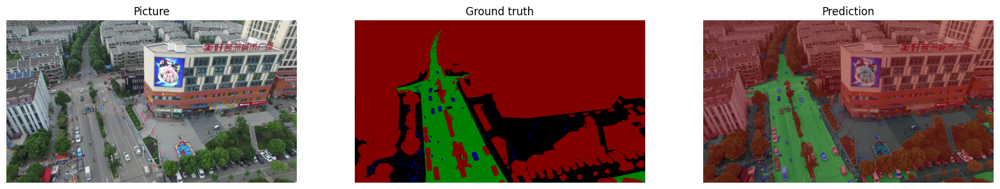

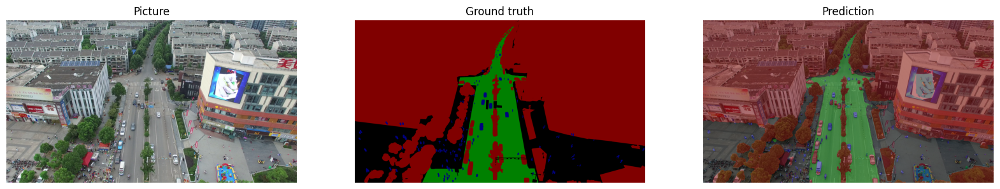

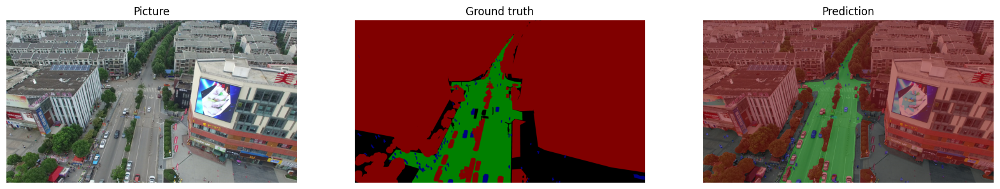

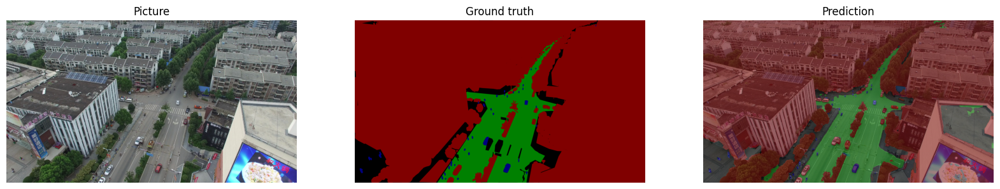

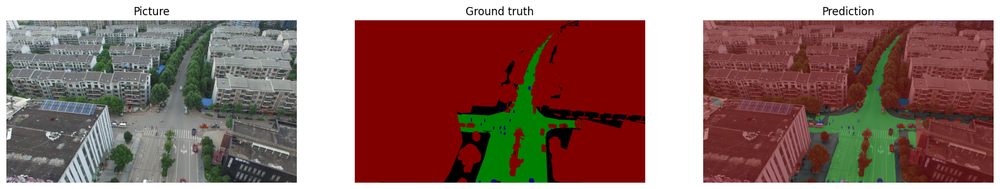

...

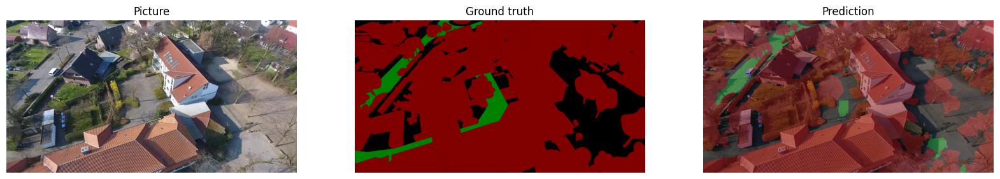

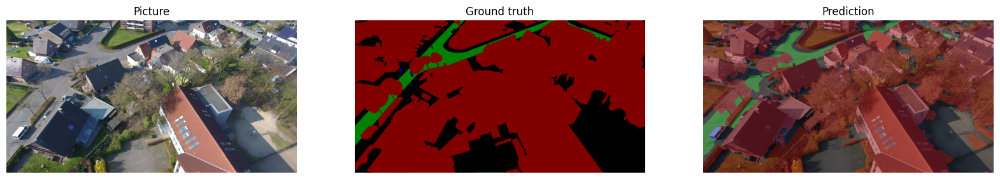

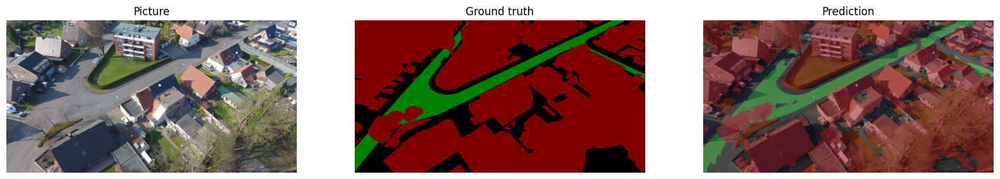

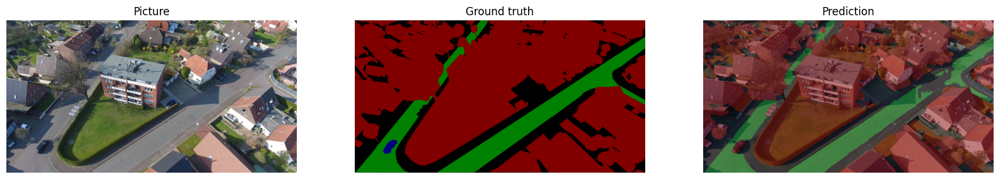

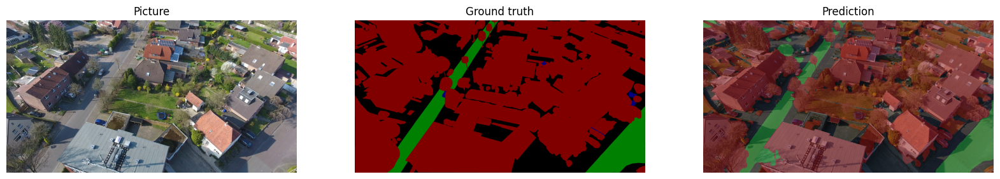

Metrics for model is : {'mIoU': 0.7637171066424229, 'F1': 0.8620967919973236, 'OA': 0.9237337557736411}
And for classes {'Static': 0.9230767193831964, 'Road': 0.7921226944012114, 'Dynamic': 0.6839316185748292, 'Clutter': 0.6557373942104545}


In [13]:
%matplotlib inline
from pathlib import Path
import glob
from PIL import Image
import ttach as tta
import cv2
import numpy as np
import torch
import albumentations as albu
from torch import nn
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
import random
import os
from utils.metric import Evaluator
import matplotlib.pyplot as plt


def seed(seed_num):
    random.seed(seed_num)
    os.environ['PYTHONHASHSEED'] = str(seed_num)
    np.random.seed(seed_num)
    torch.manual_seed(seed_num)
    torch.cuda.manual_seed(seed_num)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True


def uavid2rgb(mask):
    h, w = mask.shape[0], mask.shape[1]
    mask_rgb = np.zeros(shape=(h, w, 3), dtype=np.uint8)
    mask_convert = mask[np.newaxis, :, :]
    mask_rgb[np.all(mask_convert == 0, axis=0)] = [128, 0, 0]  # Static
    mask_rgb[np.all(mask_convert == 1, axis=0)] = [0, 128, 0]  # Road
    mask_rgb[np.all(mask_convert == 2, axis=0)] = [0, 0, 128]  # Dynamic
    mask_rgb[np.all(mask_convert == 3, axis=0)] = [0, 0, 0]  # Clutter
    return mask_rgb




Building = np.array([128, 0, 0])  # label 0 Static
Road = np.array([128, 64, 128])  # label 1 Road
Tree = np.array([0, 128, 0])  # label 0 Static
LowVeg = np.array([128, 128, 0])  # label 0 Static
Moving_Car = np.array([64, 0, 128])  # label 2 Dynamic
Static_Car = np.array([192, 0, 192])  # label 0 Static
Human = np.array([64, 64, 0])  # label 2 Dynamic
Clutter = np.array([0, 0, 0])  # label 3 Clutter
Boundary = np.array([255, 255, 255])  # label 255

num_classes = 4


def rgb2label(label):
    label_seg = np.zeros(label.shape[:2], dtype=np.uint8)
    label_seg[np.all(label == Building, axis=-1)] = 0  # Static
    label_seg[np.all(label == Road, axis=-1)] = 1  # Road
    label_seg[np.all(label == Tree, axis=-1)] = 0  # Static
    label_seg[np.all(label == LowVeg, axis=-1)] = 0  # Static
    label_seg[np.all(label == Moving_Car, axis=-1)] = 2  # Dynamic
    label_seg[np.all(label == Static_Car, axis=-1)] = 0  # Static
    label_seg[np.all(label == Human, axis=-1)] = 2  # Dynamic
    label_seg[np.all(label == Clutter, axis=-1)] = 3  # Clutter
    label_seg[np.all(label == Boundary, axis=-1)] = 255  # Boundary
    return label_seg


def get_img_padded(image, patch_size):
    oh, ow = image.shape[0], image.shape[1]
    rh, rw = oh % patch_size[0], ow % patch_size[1]

    width_pad = 0 if rw == 0 else patch_size[1] - rw
    height_pad = 0 if rh == 0 else patch_size[0] - rh
    # print(oh, ow, rh, rw, height_pad, width_pad)
    h, w = oh + height_pad, ow + width_pad

    pad = albu.PadIfNeeded(min_height=h, min_width=w, border_mode=0,
                           position='bottom_right', value=[0, 0, 0])(image=image)
    img_pad = pad['image']
    return img_pad, height_pad, width_pad


class InferenceDataset(Dataset):
    def __init__(self, tile_list=None, transform=albu.Normalize(), img_dir='images', mask_dir='masks'):
        self.tile_list = tile_list
        self.transform = transform
        self.img_dir = img_dir
        self.mask_dir = mask_dir

    def __getitem__(self, index):
        img = self.tile_list[index]
        img_id = index
        aug = self.transform(image=img)
        # transformed = self.transform(image=img.copy(), mask=mask.copy())
        img = aug['image']
        img = torch.from_numpy(img).permute(2, 0, 1).float()
        results = dict(img_id=img_id, img=img)
        return results

    def __len__(self):
        return len(self.tile_list)


def make_dataset_for_one_huge_image(img_path, mask_path, patch_size):
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    mask = cv2.imread(mask_path, cv2.IMREAD_COLOR)
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
    mask = rgb2label(mask)
    tile_list = []
    image_pad, height_pad, width_pad = get_img_padded(img.copy(), patch_size)

    output_height, output_width = image_pad.shape[0], image_pad.shape[1]

    for x in range(0, output_height, patch_size[0]):
        for y in range(0, output_width, patch_size[1]):
            image_tile = image_pad[x:x + patch_size[0], y:y + patch_size[1]]
            tile_list.append(image_tile)

    dataset = InferenceDataset(tile_list=tile_list)
    return dataset, width_pad, height_pad, output_width, output_height, image_pad, img.shape, mask, img


def get_raw_pred(model, input):
    if isinstance(model, SegFormerModule):
        output = model(input['img'].cuda("cuda:0"), None)
        raw_prediction = nn.functional.interpolate(output.logits,
                                                   size=input['img'].size(dim=2),  # (height, width)
                                                   mode='bilinear',
                                                   align_corners=False)

    elif isinstance(model.model, UnetFormerModule):
        raw_prediction = model(input['img'].cuda("cuda:0"))
        raw_prediction = nn.Softmax(dim=1)(raw_prediction)
    elif isinstance(model.model, FPNetModule):
        raw_prediction = model(input['img'].cuda("cuda:0"))
        raw_prediction = nn.Softmax(dim=1)(raw_prediction)
    return raw_prediction


def main():
    seed(42)
    image_path="/media/ami/big_space/sber_task/uavid/uavid_val" #Please Change accordinglay
    output_path="/home/ami/Semantic_Segmentation_UAVid/fig_results/uavid/unetformer" #Please Change accordinglay
    tta_m = "lr"
    patch_height = 1024
    patch_width = 1024
    batch_size = 12
    gt_exist = True
    seqs = os.listdir(image_path)

    if tta_m == "lr":
        transforms = tta.Compose(
            [
                tta.HorizontalFlip(),
                tta.VerticalFlip()
            ]
        )
    # print(img_paths)
    patch_size = (patch_height, patch_width)
    if net_name == "Unetformer":
        model = UnetFormerModule.load_from_checkpoint(os.path.join(weights_path,test_weights_name + '.ckpt'))
        model = tta.SegmentationTTAWrapper(model, transforms)
    elif net_name == "Segformer":
        model = SegFormerModule.load_from_checkpoint(os.path.join(weights_path, test_weights_name + '.ckpt'))
    elif net_name == "FPN":
        model = FPNetModule.load_from_checkpoint(os.path.join(weights_path, test_weights_name + '.ckpt'))
        model = tta.SegmentationTTAWrapper(model, transforms)

    model.cuda("cuda:0")
    model.eval()


    for seq in seqs:
        img_paths = []
        mask_paths = []
        output_path = os.path.join(output_path, str(seq), 'Labels')
        if not os.path.exists(output_path):
            os.makedirs(output_path)
        for ext in ('*.tif', '*.png', '*.jpg'):
            img_paths.extend(glob.glob(os.path.join(image_path, str(seq), 'Images', ext)))
            if gt_exist:
                mask_paths.extend(glob.glob(os.path.join(image_path, str(seq), 'Labels', ext)))
        img_paths.sort()
        if gt_exist:
            mask_paths.sort()
            eval = Evaluator(num_class=num_classes)
    
        if len(mask_paths) == 0:
            mask_paths = img_paths
    
        for img_path, mask_path in zip(img_paths, mask_paths):
            img_name = img_path.split('/')[-1]
    
            dataset, width_pad, height_pad, output_width, output_height, img_pad, img_shape, gt_mask, img = \
                make_dataset_for_one_huge_image(img_path, mask_path, patch_size)
    
            output_mask = np.zeros(shape=(output_height, output_width), dtype=np.uint8)
            output_tiles = []
            preds = []
            k = 0
            with torch.no_grad():
                dataloader = DataLoader(dataset=dataset, batch_size=batch_size,
                                        drop_last=False, shuffle=False)
                for input in tqdm(dataloader,disable=True):
                    # raw_prediction NxCxHxW
                    raw_prediction = get_raw_pred(model, input)
                    # input_images['features'] NxCxHxW C=3
                    prediction = raw_prediction.argmax(dim=1)
    
                    image_ids = input['img_id']
    
                    for i in range(prediction.shape[0]):
                        raw_mask = prediction[i].cpu().numpy()
                        mask = raw_mask
                        output_tiles.append((mask, image_ids[i].cpu().numpy()))
    
                for m in range(0, output_height, patch_size[0]):
                    for n in range(0, output_width, patch_size[1]):
                        output_mask[m:m + patch_size[0], n:n + patch_size[1]] = output_tiles[k][0]
                        k = k + 1
    
                output_mask = output_mask[-img_shape[0]:, -img_shape[1]:]
    
                output_mask_rgb = uavid2rgb(output_mask)
                gt_mask_rgb = uavid2rgb(gt_mask)
    
                output_mask_rgb = 0.5 * output_mask_rgb + 0.5 * img
                cv2.imwrite(os.path.join(output_path, img_name), output_mask_rgb)
                if gt_exist:
                    eval.add_batch(gt_mask, output_mask)
                fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
                ax1.imshow(img.astype('uint8'))
                ax1.set_title('Picture')
                ax1.set_axis_off()

                ax2.imshow(gt_mask_rgb.astype('uint8'))
                ax2.set_title('Ground truth')
                ax2.set_axis_off()

                ax3.imshow(output_mask_rgb.astype('uint8'))
                ax3.set_title('Prediction')
                ax3.set_axis_off()
                plt.show()
    
        if gt_exist:
            mIoU = np.nanmean(eval.Intersection_over_Union())
            F1 = np.nanmean(eval.F1())
    
            OA = np.nanmean(eval.OA())
            iou_per_class = eval.Intersection_over_Union()
            eval_value = {'mIoU': mIoU,
                          'F1': F1,
                          'OA': OA}
    
            iou_value = {}
            for class_name, iou in zip(classes, iou_per_class):
                iou_value[class_name] = iou
            print('Metrics for model is :', eval_value)
            print('And for classes', iou_value)

if __name__ == "__main__":
    main()
